# 95885 Project 1 
- Noopur Latkar and Angel Lee
- Presentation: https://youtu.be/yarRlu-OA6c

#DEMYSTIFYING CRIME in New York City, USA

Crime mapping and analyzing peculiar trends and patterns in crime incidents that have happened previously across the city would help police reallocate their resources to specific locations that need attention at particular hours to inhibit crime. It would also highlight racial discrimation if any, and draw attention to being fair and equal with police methods of dealing with criminals hailing from diverse socio-cultural backgrounds. It also serves as a useful tool for civilians to be aware and more vigilant of their surroundings.
<br>
<br>

New York has been divided into 5 boroughs -
- Bronx
- Manhattan
- Brooklyn
- Queens
- Staten Island

Our study ranges across -
- 5 boroughs of New York
- Through years 2006 to 2020


#MOTIVATION

- Astonishing 38.5% increase in overall index crime in NYC this year
- Your chance of being a victim of violent crime in New York is 1 in 172
- Inspiration of analyzing trends and patterns to inhibit crime sparked from a Netflix Series MindHunters that we are a big fan of.

#AGENDA : Crime Mapping

- When and where are majority crimes happening? How has that changed over time?
(Time series analysis of crime numbers and evolving crime types)
- Characteristics of criminals and their socio-cultural backgrounds
- Gun violence and its distribution across different geolocations
- Impact of social events and public holidays on shooting incidents
- Seasonal trend of shootings across months on the year, days of the month and hours of the day

#KEY FINDINGS

- Majority crime distributed across Bronx and Brooklyn
- Sudden drop in overall crime in 2017 (policy change)
- Majority criminals are Black, but so are the victims
- Decrease in overall crime but increase in shooting incidents in 2020, 2021
- Maximum shootings observed on 4th of July, 31st Dec
- Shootings spike considerably in summer months, and during wee hours of the night
- Huge parity in male victims and female victim numbers of gun shootings across all genders


#DATASETS


This research uses an extensive database of criminal records from court summons, the time and location of crime and crime type distribution in the famous city of New York.

- <b> NYPD Court Summons Data (2006 - 2021)
>  Summary </b> : A list of every criminal summons issued in NYC from year 2006 through the end of the previous calendar year. We have focused on the crime location (latitude and longitude features), type of crime, time of crime, demographic information on the criminal (age, gender, race) and crime distribution across years <br>
> https://data.cityofnewyork.us/Public-Safety/NYPD-Criminal-Court-Summons-Historic-/sv2w-rv3k <br>
 Rows : 5.3M <br>
 Columns : 17 <br>


- <b> NYPD Shooting Incident Data (2006 - 2022)
>  Summary </b> : Represents all shooting incidents in NYC from 2006 to 2022 and includes information about the event, the location and time of occurrence. Information on the suspect and victim demographics have also been explored to understand the nature of shooting/criminal activity. <br>
> https://data.cityofnewyork.us/Public-Safety/NYPD-Shooting-Incident-Data-Historic-/833y-fsy8 
https://data.cityofnewyork.us/Public-Safety/NYPD-Shooting-Incident-Data-Year-To-Date-/5ucz-vwe8 <br>
> Rows : 25.6K <br>
> Columns : 19 <br>

- <b> New York State Crime Type (1990 - 2018) 
>  Summary </b> : Index crime data consists of types of crime including minor crimes like burglary, larceny, motor vehicle theft etc. and major crimes like rape, murder and gun violence, collected from more than 500 New York State police and sheriff’s departments. We have focused on the evolvemnet of different crime types and their yearly trends. <br>
> https://www.kaggle.com/new-york-state/new-york-state-index-crimes <br>
> Rows : 19957 <br>
> Columns : 15 <br>



Combining Shooting Incident Data from 2006-2018 and 2019-2021 into one dataframe on common incident key

In [ ]:
import pandas as pd
import altair as alt
import plotly.express as go
alt.data_transformers.enable('default', max_rows=None)
df1 = pd.read_csv('NYPD_Shooting_Incident_Data__Historic_.csv')
df2 = pd.read_csv('NYPD_Shooting_Incident_Data__Year_To_Date_.csv')
print(len(df1))
print(len(df2))
df = pd.DataFrame()
df = pd.concat([df1,df2])

df['DATE'] = pd.to_datetime(df['OCCUR_DATE'])
df['TIME'] = pd.to_datetime(df['OCCUR_TIME'],format= '%H:%M:%S' ).dt.time
df['WEEK_NUMBER'] = df['DATE'].dt.week
df['DAY_OF_WEEK'] = df['DATE'].dt.day_name()
df['HOURS'] = df['OCCUR_TIME'].str.split(':').str[0]
df['MONTH'] = df['OCCUR_DATE'].str.split('/').str[0]
df['DAY'] = df['OCCUR_DATE'].str.split('/').str[1]
df['YEAR'] = df['OCCUR_DATE'].str.split('/').str[2]
df = df.drop_duplicates(subset=['INCIDENT_KEY'],keep='last')

df_nyc_summons = pd.read_csv('nyc_summons.csv')


23585
2011


/var/folders/7j/2fpmcz8d2p5fcbvmlsfmvfgw0000gn/T/ipykernel_34575/1855473059.py:14: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  df['WEEK_NUMBER'] = df['DATE'].dt.week
/usr/local/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3444: DtypeWarning: Columns (8) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
df.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,JURISDICTION_CODE,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,...,Lon_Lat,New Georeferenced Column,DATE,TIME,WEEK_NUMBER,DAY_OF_WEEK,HOURS,MONTH,DAY,YEAR
1,77673979,03/11/2011,12:03:00,QUEENS,106,0.0,NaN,False,NaN,NaN,...,POINT (-73.84392019199998 40.677366895000034),NaN,2011-03-11,12:03:00,10,Friday,12,03,11,2011
3,80584527,09/04/2011,03:35:00,BRONX,40,0.0,NaN,False,NaN,NaN,...,POINT (-73.91618413199996 40.80879780500004),NaN,2011-09-04,03:35:00,35,Sunday,03,09,04,2011
4,90843766,05/27/2013,21:16:00,QUEENS,100,0.0,NaN,False,NaN,NaN,...,POINT (-73.79468553799995 40.597796249000055),NaN,2013-05-27,21:16:00,22,Monday,21,05,27,2013
6,73057167,06/05/2010,21:16:00,BROOKLYN,77,0.0,NaN,False,NaN,NaN,...,POINT (-73.93779204599997 40.67185839800004),NaN,2010-06-05,21:16:00,22,Saturday,21,06,05,2010
7,211362213,03/20/2020,21:27:00,BROOKLYN,81,0.0,NaN,False,NaN,NaN,...,POINT (-73.93749012499995 40.68773229400006),NaN,2020-03-20,21:27:00,12,Friday,21,03,20,2020


In [ ]:
df_year_counts = pd.read_csv('df_year_counts.csv')
df_year_counts.columns=['year','SUMMONS_KEY']
source = df_year_counts

alt.Chart(source).mark_area(
    line={'color':'darkgreen'},
    color=alt.Gradient(
        gradient='linear',
        stops=[alt.GradientStop(color='white', offset=0),
               alt.GradientStop(color='darkgreen', offset=1)],
        x1=1,
        x2=1,
        y1=1,
        y2=0
    )
).encode(
    alt.X('year:O', title='Year'),
    alt.Y('SUMMONS_KEY:Q', title = 'Number of Crime')
).properties(
    title='Overall Crime Trend',
    width = 400
)

Area chart with gradient represents the trend of overall crime numbers in New York City over years 2006 ~ 2020 recorded across all boroughs of the city. <br><br> Inference : A decreasing trend in observed in the overall crime index in NYC from 2009 to 2020. These numbers include all major and minor crimes.

In [ ]:
source = df_nyc_summons.groupby(['year','SUMMONS_CATEGORY_TYPE']).count()[['SUMMONS_KEY']].reset_index()

alt.Chart(source).mark_bar().encode(
    x='year:O',
    y=alt.Y('SUMMONS_KEY:Q', title='Number of Incidents'),
    # color=alt.Color('SUMMONS_CATEGORY_TYPE',  title='Crime Type')
).properties(
    title='Decreasing Overall Crime Trend across years'
)

A different representation (bar chart) of the same analysis as above that the crime is on a decline in recent years.

In [ ]:
source = df_nyc_summons.groupby(['year','SUMMONS_CATEGORY_TYPE']).count()[['SUMMONS_KEY']].reset_index()

alt.Chart(source).mark_bar().encode(
    x='year:O',
    y=alt.Y('SUMMONS_KEY:Q', title='Number of Incidents'),
    color=alt.Color('SUMMONS_CATEGORY_TYPE',  title='Crime Type')
).properties(
    title='Decreasing Overall Crime Trend across years'
)

Deep-diving into the categories of crime, we explored that NYPD has divided crime into 65+ categories ranging from minor crimes like burglary, larceny, motor vehicle theft etc, to major crimes like rape, murder, gun violence, etc. reprrsented by different colours in this stacked bar chart. This is just to give a brief idea of the vast number of categories, and we will be focusing on gun violence (major crime) in the later part of the project.

In [ ]:
source = df_nyc_summons[df_nyc_summons['year']>2015].groupby(['year','month']).count()[['SUMMONS_KEY']].reset_index()
alt.Chart(source).mark_line().encode(
    x=alt.X('month:O',title='Month'),
    y=alt.Y('SUMMONS_KEY:Q',title='Number of Crimes'),
    color=alt.Color('year:N')
    # strokeDash='symbol',
).properties(
    title='Monthly Number of Crimes by year (2016~2020)',
    width=400
)

This multi-line graph plots number of crimes across months of each year from 2016 to 2020, where each colored line reprersents a unique year.

A sharp decline in 2017 

In [ ]:
source = df_nyc_summons[df_nyc_summons['year']>2015].groupby(['year','month']).count()[['SUMMONS_KEY']].reset_index()
highlight = alt.selection(type='single', on='mouseover',
                          fields=['month'], nearest=True, empty="none")

background = alt.Chart(source[source['year']!=2017]).mark_line().encode(
    x=alt.X('month:O',title='Month'),
    y=alt.Y('SUMMONS_KEY:Q',title='Crime Incidents'),
    color=alt.condition( highlight, 'year:N', alt.value("lightgray")),
    tooltip=["MONTH:N", "SUMMONS_KEY"],
).add_selection(
    highlight
)


foreground = alt.Chart(source[source['year']==2017]).mark_line(color= "red").encode(
    x=alt.X('month:O',title='Month'),
    y=alt.Y('SUMMONS_KEY:Q',title='Crime Incidents'),
    color=alt.Color('year:N')
).properties(
    title='Monthly Number of Crimes by year (2016~2020)',
    width=400
)
foreground + background

Highlighted Multi-line Graph - plots number of crimes across months of each year from 2016 to 2020. The purpose of this highlighted multi-line graph is to draw attention to a sudden descend in the crime numbers in the year 2017, and this trend of reduced crime numbers continues in 2018 and onwards. <br> <br>

Inference : We further researched outside of the dataset, and found out that NYC abandoned the Stop-and-Frisk policy in 2017. The stop-and-frisk poicy allowed police to stop, question, and search civilians on the street for weapons and other contraband, based on mere suspicion of wrongdoing. This policy was racially discriminated and unconstitutional, as 83% of the stops involved Black and Latino people, therefore it was ordered to stop. After the abandonment of the stop-and-frisk policy, the total crime index decreased, and has stayed so after that. <br>

(Reference : https://eji.org/news/new-york-crime-falls-as-police-end-stop-and-frisk/ )



In [ ]:
source = df_nyc_summons[df_nyc_summons['year']==2019]
source = source[source.BORO.notnull()]
# source = source[source['YEAR']=='2018']
source['BORO'].loc[(source['BORO'] == 'NEW YORK')] = 'MANHATTEN'

alt.data_transformers.enable('default', max_rows=None)
rng = ['blue', 'green', 'red', 'orange','pink']
alt.Chart(source).mark_circle(
     opacity = 0.2,
).encode(
    longitude='Longitude:Q',
    latitude='Latitude:Q',
    size=alt.value(3),
    # tooltip='VIC_RACE',
    color = alt.Color('BORO:N', scale=alt.Scale(range=rng))
).project(
    "mercator"
).properties(
    title = 'Borough-wise Crime Distribution',
    width=600,
    height=500
)

Scatter Plot in Geographic Coordinates - plots all crime committed across 5 boroughs of New York City, each represented by a unique color, according to its geo-location (lat-long) in the shape of the map of New York City. <br> <br>

Inference : As New York City consists of 5 main boroughs, we found out that the top three areas of crime concentration are Brooklyn, Bronx, and Manhatten. People should be more aware of their surroundings when they are in these areas, and this could be a reference for the police department to more efficiently allocate their forces in these areas.


In [ ]:
source = df_nyc_summons[df_nyc_summons['year']==2019]
# source = source[source.BORO.notnull()]
source = source[(source['RACE']!='UNKNOWN')&(source['RACE']!='OTHER')&(source['RACE']!='AMERICAN INDIAN/ALASKAN NATIVE')&(source.RACE.notnull())]
# source = source[source['YEAR']=='2018']

alt.data_transformers.enable('default', max_rows=None)
rng = ['blue', 'red', 'green', 'pink','purple']
alt.Chart(source).mark_circle(
     opacity = 0.2,
).encode(
    longitude='Longitude:Q',
    latitude='Latitude:Q',
    size=alt.value(3),
    # tooltip='VIC_RACE',
    color = alt.Color('RACE:N', scale=alt.Scale(range=rng))
).project(
    "mercator"
).properties(
    title = 'Borough-wise Crime Distribution by Race (2019)',
    width=600,
    height=500
)

alt.Chart(...)

Scatter Plot in Geographic Coordinates - plots all crime committed across 5 boroughs of New York City in 2019 by criminals of different races, each race represented by a unique color, according to the crime's geo-location (lat-long) in the shape of the map of New York City. <br> <br>

Inference : After a study of the characteristics of criminals and their socio-cultural backgrounds, it has been observed that
majority of the criminals summoned in courts till date belong the Black race <br> <br> 
- Majority criminals in Brooklyn belong to the Black race
- Majority crime in Bronx by Black community and Black Hispanic community
- Crime in North Queens dominated by Whites and White Hispanic community
- Concentration of Asian and Pacific Islander criminals in South Brooklyn
<br> <br>

Insight : This distribution shows that particular races may be more often incorrectly convicted at certain locations due to racially discriminatory actions, as we learned that from the stop-and-frisk policy.


# After a comprehensive analyis of the Overall Crime Trend in New York City, we now focus on one major crime - GUN VIOLENCE

<AxesSubplot:xlabel='YEAR'>

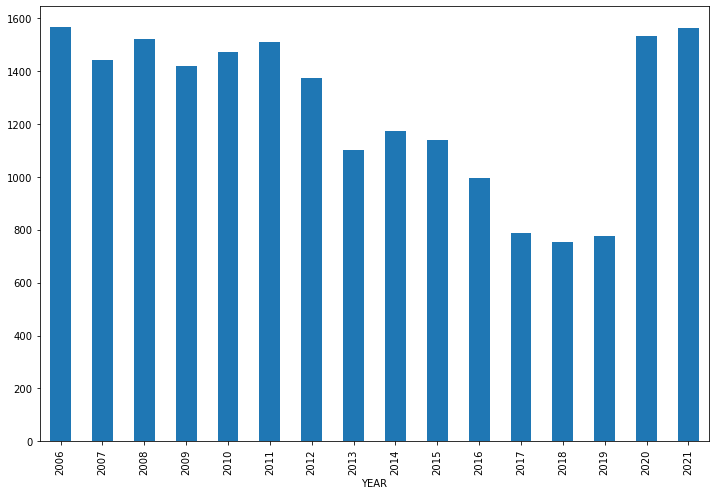

In [ ]:
df.groupby(['YEAR']).count()[['INCIDENT_KEY']].unstack('YEAR')[('INCIDENT_KEY')].plot.bar(figsize=(12,8))

Bar chart : represents number of shooting incidents across years 2006 ~ 2021. There is an evident decline in teh trend till year 2019, after which shootings have spiked in year 2020 and 2021.

In [ ]:
import plotly.express as px

source = df.groupby(['YEAR']).count()[['INCIDENT_KEY']][['INCIDENT_KEY']].reset_index()
fig = px.bar(source, x='YEAR', y='INCIDENT_KEY',
             hover_data=['YEAR','INCIDENT_KEY'], 
             color='INCIDENT_KEY',
             labels={'INCIDENT_KEY':'Shooting Incidents', 'YEAR':"Year"}, 
             height=300,
             width = 1000)
fig.show()

Plotly Coloured Bar Chart - plots count of shooting incidents across all boroughs for years 2006~2021, each bar representing a distinct year. The trend shows an unusual spike in 2020 and 2021.

In [ ]:
source = df[df['YEAR']=='2020']
fig = go.density_mapbox(source, lat='Latitude', lon='Longitude', radius=5, zoom=9,
                        color_continuous_scale=go.colors.sequential.YlOrRd,
                        mapbox_style="stamen-terrain",width=600, height=600)
fig.update_layout(
        title = 'Shootings Density Heatmap',
)
fig.show()

Plotly Mapbox Density Heatmap - overlays shooting incidents on the map of New York City using geolocation of crime records across all 5 boroughs for the year 2020. 

Inference : 
- Majority shooting incidents in 2020 are concentrated in Bronx and Brooklyn
- Shooting incidents recorded in Staten Island are the lowest in number in 2020
- Staten Island considered one of the safest places in New York <br> ( Reference : https://www.neighborhoodscout.com/ny/staten-island/crime#description ) 

In [ ]:
# df.groupby(['YEAR','BORO']).count()[['INCIDENT_KEY']].unstack('BORO')[('INCIDENT_KEY')].plot(figsize=(12,8))

source = df.groupby(['YEAR','BORO']).count()[['INCIDENT_KEY']].reset_index()

alt.Chart(source).mark_line().encode(
    x=alt.X('YEAR',title='Year'),
    y=alt.Y('INCIDENT_KEY',title='Shooting Incidents'),
    color='BORO',
    # strokeDash='symbol',
).properties(
    title='Annual number of Shootings Trend by Boro',
    width=400
)

alt.Chart(...)

Multi-line graph - plots shooting incidents across years 2006 ~ 2021 for 5 boroughs, each represented by a distinct colored line. <br><br>
Insights:
- Bronx and Brooklyn : Major drop in 2017, lowest levels in more than six decades (can be attributed to the stop-and-frisk policy as discussed earlier)
- Bronx and Brooklyn : Major spike in 2020, more shootings than any year in the last decade <br> <br>

Inference for sudden spike in shooting incidents in 2020 : <br>
1. Black Lives Matter Protests 
>- Death of George Floyd in May, 2020
>- Protests reinforced communities’ distrust of law enforcement
>- Protests scared law enforcement officers from doing proactive policing necessary to prevent crime
>- Criminals have emboldened as police back off from aggressive tactics
>- Reference : https://www.vox.com/policy-and-politics/2017/9/25/16360606/murder-rate-2016-fbi <br><br>
> Actionable Insights : Inspite of this unfortunate incident that led to the protests, its important for the police department to continue strict patrolling, but ensure it's fair across all genders and races. 

2. Impact of COVID
>- Economic and physical strain of the virus
>- Covid disproportionately took lives in neighborhoods that were already struggling with high levels of gun violence
>- Overall increased agitation amongst people from weak economic backgrounds due to helplessness
>- Unemployment rate on a rise <br><br>
>- Reference : https://www.thecity.nyc/2020/12/21/22189682/why-are-shootings-up-in-new-york-city-in-2020-nypd <br> <br>
> Actionable Insights : Government should be sensitive to this situation and extend maximum support to people with weak economic backgrounds

 




In [ ]:
source = df.groupby(['MONTH','YEAR']).count()[['INCIDENT_KEY']].reset_index()

# Scatter Plot with Rolling Mean

line = alt.Chart(source).mark_line(
    color='red',
    size=3
).transform_aggregate(
    value='mean(INCIDENT_KEY)', groupby=['MONTH']
).encode(
    x=alt.X('MONTH:N', title ='Months'),
    y='value:Q'
).properties(
    title = 'Monthly Shooting Incidents Trend',

)

points = alt.Chart(source).mark_point().encode(
    x=alt.X('MONTH:N', title ='Months'),
    y=alt.Y('INCIDENT_KEY:Q',
            axis=alt.Axis(title='Shooting Incidents'))
).properties(
    width=400,
    height=200
)

line.configure_title(
    fontSize=20,
    font='Courier',
    anchor='start',
    color='gray'
)
points + line

alt.LayerChart(...)

Scatter Plot with Rolling Mean - visualizes monthly trend of count of shooting incidents across years 2006 ~ 2021. The x-axis represents months in numerical format. Red line depicts the mean shooting incidents recorded each month. <br> <br> 

Inference :
- Majority shootings from May to September i.e Summer season
- Shootings peak in August of every year <br> <br>

Actinable Insights : This could be attributed to more people coming out on the streets in the summers and can be a reference for the police to allocate resources more during the summer than the winters to prevent shootings.

In [ ]:
# df.groupby(['HOURS','BORO']).count()[['INCIDENT_KEY']].unstack('BORO')[('INCIDENT_KEY')].plot(figsize=(12,8))

source = df.groupby(['HOURS','BORO']).count()[['INCIDENT_KEY']].reset_index()

alt.Chart(source).mark_line().encode(
    x=alt.X('HOURS',title='Hours'),
    y=alt.Y('INCIDENT_KEY',title='Shooting Incidents'),
    color='BORO',
    # strokeDash='symbol',
).properties(
    title='Hourly number of Shoorings Trend by Boro'
)

alt.Chart(...)

Multi-line graph - visualizes hourly trend of count of shooting incidents across years 2006 ~ 2021 and months Jan ~ Dec for all boroughs. The x-axis represents hours in 24-hour format. Each line represents a borough in distinct color.

In [ ]:
# Scatter Plot with Rolling Mean
source = df.groupby(['MONTH','HOURS']).count()[('INCIDENT_KEY')].reset_index()

line = alt.Chart(source).mark_line(
    color='red',
    size=3
).transform_aggregate(
    value='mean(INCIDENT_KEY)', groupby=['HOURS']
).encode(
    x=alt.X('HOURS:Q',title='Hours'),
    y='value:Q'
)

points = alt.Chart(source).mark_point().encode(
     x=alt.X('HOURS:Q',title='Hours'),
    y=alt.Y('INCIDENT_KEY:Q',
            axis=alt.Axis(title='Shooting Incidents'))
).properties(
    title='Hourly Shooting Incidents Trend'
)

points + line

alt.LayerChart(...)

Scatter Plot with Rolling Mean - better visualizes hourly trend of count of shooting incidents across years 2006 ~ 2021 and months Jan ~ Dec. The x-axis represents hours in 24-hour format. Red line depicts the mean shooting incidents recorded each hour. The trend remains similar across all boroughs. <br> <br> 

Inference :
- Majority shootings happen during the night time
- Shootings peak between 12 am in the night 
- Significantly less number of shootings during the day-time<br> <br>

Actinable Insights : Civilians should be careful during the night time and vigilant of their surroundings.

In [ ]:
# Pandas Time Series
source = df.groupby(['YEAR','HOURS']).count()[['INCIDENT_KEY']].reset_index()
alt.Chart(source).mark_rect().encode(
    alt.X('HOURS:O', title='Hours'),
    alt.Y('YEAR:O', title='Year'),
    alt.Color('INCIDENT_KEY:Q', title='Shooting Incidents')
).properties(
    title='Hourly Trend of Shooting Incidents by Year ',
    bounds='flush'
)

alt.Chart(...)

Time Series Analysis in Altair using Heatmap - enhances the same idea of hourly trend of shooting incidents across years 2006 ~ 2021 and months Jan ~ Dec. The x-axis represents hours in 24-hour format. Darker shades represent more concentration of shootings, lighter shades are relatively safer hours of the day. <br> <br>

Inference -
- Lowest number of shootings betwen 5am and 5pm (safest time)
- Highest shootings between 10pm and 3am (unsafe time)

In [ ]:
# df.groupby(['MONTH','DAY']).count().unstack('MONTH')[['INCIDENT_KEY']].plot.line(figsize=(15,8))
source = df.groupby(['MONTH','DAY']).count()[['INCIDENT_KEY']].reset_index()
alt.Chart(source).mark_line().encode(
    x=alt.X('DAY:O',title='Day'),
    y=alt.Y('INCIDENT_KEY:Q',title='Shooting Incidents'),
    color='MONTH',
    # strokeDash='symbol',
).properties(
    title='Daily number of Shoorings Trend by Month'
)

alt.Chart(...)

Multi-line graph - plots date-wise trend of shooting incidents across all years (2006 ~ 2021) for 12 months, where each distinct line represents a month. A sudden spike is observed in the line depicting the month of July, common to all years. Exploring this further. 

In [ ]:
source = df.groupby(['MONTH','DAY']).count()[['INCIDENT_KEY']].reset_index()

highlight = alt.selection(type='single', on='mouseover',
                          fields=['DAY'], nearest=True, empty="none")

background = alt.Chart(source[source['MONTH']!='07']).mark_line().encode(
    x=alt.X('DAY:O',title='Day'),
    y=alt.Y('INCIDENT_KEY:Q',title='Shooting Incidents'),
    color=alt.condition( highlight, 'MONTH:N', alt.value("lightgray")),
    tooltip=["MONTH:N", "INCIDENT_KEY"],
).add_selection(
    highlight
)


foreground = alt.Chart(source[source['MONTH']=='07']).mark_line(color= "red").encode(
    x=alt.X('DAY:O',title='Day'),
    y=alt.Y('INCIDENT_KEY:Q',title='Shooting Incidents'),
    color=alt.Color('MONTH:N')
).properties(
    title='Daily number of Shoorings Trend by Month'
)
foreground + background

alt.LayerChart(...)

Highlighted Multi-line graph - We’ve found that the most shootings through the year have been on exactly ONE day, the 4th of July. It is to our surprise as we thought that this is a day when most people go out and celebrate, but infact Fourth of July weekend is marred by violence. <br> <br>

Inference : As we deep dived into past news, we found that 4th of july is a day a day when people with the intend to draw attention to plan and execute shootings. This insight could be used as a reference for the police department to monitor and increase security level before 4th of july to prevent shootings from happening in the future.

Reference : https://www.insider.com/mass-shootings-in-us-over-fourth-of-july-weekend-2021-7 



In [ ]:
# .unstack('VIC_SEX')[('INCIDENT_KEY')].plot(figsize=(12,8))
source = df[(df['VIC_SEX']=='F')|(df['VIC_SEX']=='M')].groupby(['YEAR','VIC_SEX']).count()[['INCIDENT_KEY']].reset_index()

base = alt.Chart(source).encode(
    x=alt.X("YEAR:O",title='Year'),
)

line = base.mark_line().encode(
    x=alt.X("YEAR:O",title='Year'),
    y=alt.Y("INCIDENT_KEY:Q", title='Number of Victims', stack=None),
    color=alt.Color("VIC_SEX:N", title='Victim Gender',
                   scale=alt.Scale(
            domain=['M', 'F'],
            range=['blue', 'red'])
            )
).properties(
    title='Yearly number of Shooting Victims Trend by Gender'
)

source = df[(df['VIC_SEX']=='F')|(df['VIC_SEX']=='M')].groupby(['YEAR','VIC_SEX']).count()[['INCIDENT_KEY']].unstack('VIC_SEX')[('INCIDENT_KEY')].reset_index()
source = source[['YEAR','F','M']]
source['Female_Percentage'] = (source['F'] / (source['F'] + source['M']))

base = alt.Chart(source).encode(
    x=alt.X("YEAR:O",title='Year'),
)

line_percentage = base.mark_line().encode(
    x=alt.X("YEAR:O",title='Year'),
    y=alt.Y("Female_Percentage:Q", title='Percentage of Female Victims', stack=None),
    
).properties(
    # title='Yearly number of Shoorings Trend by Gender'
)

alt.layer(line).resolve_scale(
    y = 'independent'
)

alt.LayerChart(...)

Multi-line Graph - plots victims of shootings against years (2006 ~ 2021) for genders male(blue line) and female(red line). 

In [ ]:
source = df[(df['VIC_SEX']=='F')|(df['VIC_SEX']=='M')].groupby(['YEAR','VIC_SEX']).count()[['INCIDENT_KEY']].unstack('VIC_SEX')[('INCIDENT_KEY')].reset_index()
d = {'Gender': ['F','M'], 'Number of Victims': [source.F.sum(), source.M.sum()]}
source = pd.DataFrame(data=d)
alt.Chart(source).mark_bar().encode(
    x='Number of Victims:Q',
    y="Gender:N",
    color=alt.Color("Gender:N", title='Victim Gender',
                   scale=alt.Scale(
            domain=['M', 'F'],
            range=['blue', 'red'])
            )
).properties(height=80)


alt.Chart(...)

Horizontal bar chart - This is to emphasize on the huge parity in the numbers, with male victims at 92.3% and female victims at just 7.6%

In [ ]:
source['percent'] = (source['Number of Victims'] / source['Number of Victims'].sum()) * 100
source

,Gender,Number of Victims,percent
0,F,1533,7.620042
1,M,18585,92.379958


In [ ]:
# Dual Horizontal Bar Chart
source = df.groupby(['YEAR','VIC_SEX','VIC_RACE']).count()[['INCIDENT_KEY']].reset_index()
source['Year'] = source['YEAR'].astype(int)
source = source[source['VIC_RACE']!='UNKNOWN']
source = source[source['VIC_RACE']!='AMERICAN INDIAN/ALASKAN NATIVE']
source['men_women'] = source['VIC_SEX'].map({'M': 1, 'F': 2})

slider = alt.binding_range(min=2010, max=2021, step=1)
select_year = alt.selection_single(name='Year', fields=['Year'],
                                   bind=slider, init={'Year': 2020})

base = alt.Chart(source).add_selection(
    select_year
).transform_filter(
    select_year
).transform_calculate(
    gender=alt.expr.if_(alt.datum.men_women == 1, 'Male', 'Female')
).properties(
    width=400,
    height=150
)


color_scale = alt.Scale(domain=['Male', 'Female'],
                        range=['#1f77b4', '#e377c2'])
max_value = df.groupby(['YEAR','VIC_SEX','VIC_RACE']).count()[['INCIDENT_KEY']].reset_index()['INCIDENT_KEY'].max()
left = base.transform_filter(
    alt.datum.gender == 'Female'
).encode(
    y=alt.Y('VIC_RACE:O', axis=None),
    x=alt.X('INCIDENT_KEY:Q',
            title='Number of Shootings',
            sort=alt.SortOrder('descending'),
            scale=alt.Scale(domain=[0, max_value])),
    color=alt.Color('gender:N', scale=color_scale, legend=None)
).mark_bar().properties(title='Female')

middle = base.encode(
    y=alt.Y('VIC_RACE:O', axis=None),
    text=alt.Text('VIC_RACE:N'),
).mark_text().properties(width=20)

right = base.transform_filter(
    alt.datum.gender == 'Male'
).encode(
    y=alt.Y('VIC_RACE:O', axis=None),
    x=alt.X('INCIDENT_KEY:Q', 
    title='Number of Shootings',
    scale=alt.Scale(domain=[0, max_value])),
    color=alt.Color('gender:N', scale=color_scale, legend=None)
).mark_bar().properties(title='Male')

alt.concat(middle, left, right, spacing=5)

alt.ConcatChart(...)

Population pyramid - shows the distribution of genders, race-wise, within a population of victims of shootings. It has a slider widget that is bound to years 2010 to 2021 to visualize the race distribution of victims over time.

Insights -
- Victim numbers decline from 2010 to 2015
- Victim numbers increase from 2015 - 2021
- Majority victims constitute of Black males
- Majority victims in 2021
- Black hispanics were targetted more than white hispanics in 2010, that flipped in 2021 where wite hispanic victims are now more in number.


Summary
- We have identified trends and patterns in crime incidents, and these findings could help police reallocate their resources to specific locations at specific time to help prevent potential crimes. 
- In addition, residents and travelers could refer to our analysis and prevent visiting certain areas at more dangerous time in order to stay away from potential risk of danger.

Future scope
- We could implement Geospatial Clustering to find unsafe neighbourhoods using lat-long features, and identify more specific corners to avoid
- Combine police department personnel data and analyze on how we could maximize the coverage of police patrolling at identified unsafe areas at particular timings, by involving police patrolling schedules in the analysis



---------